-------------------------------------------------------------------------------------------------------------------------------
## <center><font color='black'> DEEPTHI SUDHARSAN - DL PROJECT 1 </font></center>
## <center><font color='black'> Higgs Boson Discovery using deep learning </font></center>
## <center><font color='black'> INDEX </font></center>
### <a href='#import'> IMPORTING LIBRARIES</a>
### <a href='#eda'> EXPLORATORY DATA ANALYSIS</a>
#### <a href='#autoviz'> a) EDA using Autoviz</a>
#### <a href='#dabl'> b) EDA using DABL</a>
### <a href='#pre'> PRE-PROCESSING AND FEATURE ENGINEERING</a>
### <a href='#dl'> DEEP LEARNING MODELS</a>
### <a href='#mlp'> 1. MLP</a>
### <a href='#ann'> 2. ANN</a>
### <a href='#auto'> 3. Autoencoder</a>
### <a href='#rnn'> 4. RNN</a>

<a id='import'></a>

### IMPORTING LIBRARIES

In [1]:
import pandas as pd
import dabl
import warnings
warnings.filterwarnings("ignore") 
from autoviz.AutoViz_Class import AutoViz_Class
from sklearn.preprocessing import LabelEncoder 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.ensemble import IsolationForest
from collections import Counter
import seaborn as sb
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input,Dense, LSTM,Dropout,SimpleRNN
from sklearn.metrics import accuracy_score
from tensorflow.keras.models import Model

Imported AutoViz_Class version: 0.0.83. Call using:
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not show plot but creates them and saves them in AutoViz_Plots directory in your local machine.


<a id='eda'></a>

### EDA

In [2]:
dataset = pd.read_csv("Dataset and Details/Dataset.csv") # Reading the dataset

In [3]:
dataset

,EventId,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,...,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight,Label
0,100000,138.470,51.655,97.827,27.980,0.91,124.711,2.666,3.064,41.928,...,2,67.435,2.150,0.444,46.062,1.24,-2.475,113.497,0.002653,s
1,100001,160.937,68.768,103.235,48.146,-999.00,-999.000,-999.000,3.473,2.078,...,1,46.226,0.725,1.158,-999.000,-999.00,-999.000,46.226,2.233584,b
2,100002,-999.000,162.172,125.953,35.635,-999.00,-999.000,-999.000,3.148,9.336,...,1,44.251,2.053,-2.028,-999.000,-999.00,-999.000,44.251,2.347389,b
3,100003,143.905,81.417,80.943,0.414,-999.00,-999.000,-999.000,3.310,0.414,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,5.446378,b
4,100004,175.864,16.915,134.805,16.405,-999.00,-999.000,-999.000,3.891,16.405,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,6.245333,b
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249995,349995,-999.000,71.989,36.548,5.042,-999.00,-999.000,-999.000,1.392,5.042,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,4.505083,b
249996,349996,-999.000,58.179,68.083,22.439,-999.00,-999.000,-999.000,2.585,22.439,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,2.497259,b
249997,349997,105.457,60.526,75.839,39.757,-999.00,-999.000,-999.000,2.390,22.183,...,1,41.992,1.800,-0.166,-999.000,-999.00,-999.000,41.992,0.018636,s
249998,349998,94.951,19.362,68.812,13.504,-999.00,-999.000,-999.000,3.365,13.504,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,1.681611,b


In [4]:
dataset.drop("EventId", axis = 1, inplace = True)
dataset.head()

,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight,Label
0,138.470,51.655,97.827,27.980,0.91,124.711,2.666,3.064,41.928,197.760,...,2,67.435,2.150,0.444,46.062,1.24,-2.475,113.497,0.002653,s
1,160.937,68.768,103.235,48.146,-999.00,-999.000,-999.000,3.473,2.078,125.157,...,1,46.226,0.725,1.158,-999.000,-999.00,-999.000,46.226,2.233584,b
2,-999.000,162.172,125.953,35.635,-999.00,-999.000,-999.000,3.148,9.336,197.814,...,1,44.251,2.053,-2.028,-999.000,-999.00,-999.000,44.251,2.347389,b
3,143.905,81.417,80.943,0.414,-999.00,-999.000,-999.000,3.310,0.414,75.968,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,5.446378,b
4,175.864,16.915,134.805,16.405,-999.00,-999.000,-999.000,3.891,16.405,57.983,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,6.245333,b


In [5]:
dataset.isna().sum()

DER_mass_MMC                   0
DER_mass_transverse_met_lep    0
DER_mass_vis                   0
DER_pt_h                       0
DER_deltaeta_jet_jet           0
DER_mass_jet_jet               0
DER_prodeta_jet_jet            0
DER_deltar_tau_lep             0
DER_pt_tot                     0
DER_sum_pt                     0
DER_pt_ratio_lep_tau           0
DER_met_phi_centrality         0
DER_lep_eta_centrality         0
PRI_tau_pt                     0
PRI_tau_eta                    0
PRI_tau_phi                    0
PRI_lep_pt                     0
PRI_lep_eta                    0
PRI_lep_phi                    0
PRI_met                        0
PRI_met_phi                    0
PRI_met_sumet                  0
PRI_jet_num                    0
PRI_jet_leading_pt             0
PRI_jet_leading_eta            0
PRI_jet_leading_phi            0
PRI_jet_subleading_pt          0
PRI_jet_subleading_eta         0
PRI_jet_subleading_phi         0
PRI_jet_all_pt                 0
Weight    

In [6]:
dataset.info()
# prints information about a DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 250000 entries, 0 to 249999
Data columns (total 32 columns):
DER_mass_MMC                   250000 non-null float64
DER_mass_transverse_met_lep    250000 non-null float64
DER_mass_vis                   250000 non-null float64
DER_pt_h                       250000 non-null float64
DER_deltaeta_jet_jet           250000 non-null float64
DER_mass_jet_jet               250000 non-null float64
DER_prodeta_jet_jet            250000 non-null float64
DER_deltar_tau_lep             250000 non-null float64
DER_pt_tot                     250000 non-null float64
DER_sum_pt                     250000 non-null float64
DER_pt_ratio_lep_tau           250000 non-null float64
DER_met_phi_centrality         250000 non-null float64
DER_lep_eta_centrality         250000 non-null float64
PRI_tau_pt                     250000 non-null float64
PRI_tau_eta                    250000 non-null float64
PRI_tau_phi                    250000 non-null float64
PRI_lep_p

In [7]:
dataset.describe()
# describe() is used to view some basic statistical details like percentile, mean, std etc. of a data frame 
# or a series of numeric values. 

,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_met_sumet,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight
count,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,...,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000
mean,-49.023079,49.239819,81.181982,57.895962,-708.420675,-601.237051,-709.356603,2.373100,18.917332,158.432217,...,209.797178,0.979176,-348.329567,-399.254314,-399.259788,-692.381204,-709.121609,-709.118631,73.064591,1.646767
std,406.345647,35.344886,40.828691,63.655682,454.480565,657.972302,453.019877,0.782911,22.273494,115.706115,...,126.499506,0.977426,532.962789,489.338286,489.333883,479.875496,453.384624,453.389017,98.015662,1.875103
min,-999.000000,0.000000,6.329000,0.000000,-999.000000,-999.000000,-999.000000,0.208000,0.000000,46.104000,...,13.678000,0.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,0.000000,0.001502
25%,78.100750,19.241000,59.388750,14.068750,-999.000000,-999.000000,-999.000000,1.810000,2.841000,77.550000,...,123.017500,0.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,0.000000,0.018636
50%,105.012000,46.524000,73.752000,38.467500,-999.000000,-999.000000,-999.000000,2.491500,12.315500,120.664500,...,179.739000,1.000000,38.960000,-1.872000,-2.093000,-999.000000,-999.000000,-999.000000,40.512500,1.156188
75%,130.606250,73.598000,92.259000,79.169000,0.490000,83.446000,-4.593000,2.961000,27.591000,200.478250,...,263.379250,2.000000,75.349000,0.433000,0.503000,33.703000,-2.457000,-2.275000,109.933750,2.404128
max,1192.026000,690.075000,1349.351000,2834.999000,8.503000,4974.979000,16.690000,5.684000,2834.999000,1852.462000,...,2003.976000,3.000000,1120.573000,4.499000,3.141000,721.456000,4.500000,3.142000,1633.433000,7.822543


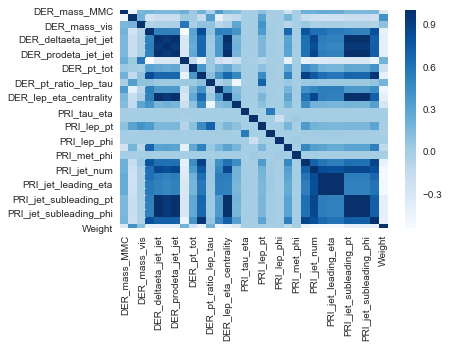

In [8]:
corr = dataset.corr()
sb.heatmap(corr, cmap="Blues")

In [9]:
dataset["Label"].value_counts() # counting the occurence of the unique labels

b    164333
s     85667
Name: Label, dtype: int64

<a id='autoviz'></a>
#### EDA using Autoviz auto EDA library

    Since nrows is smaller than dataset, loading random sample of 50000 rows into pandas...
Shape of your Data Set loaded: (50000, 32)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  30
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  1
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    32 Predictors classified...
        This does not include the Target column(s)
        No variables removed since no ID or low-information variables found in data set
Since Number of Rows in data 50000 exceeds maximum, randomly sampling 50000 rows for EDA...
30 numeric variables in data exceeds limit

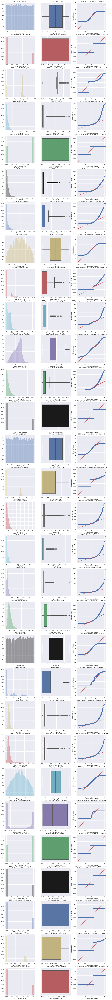

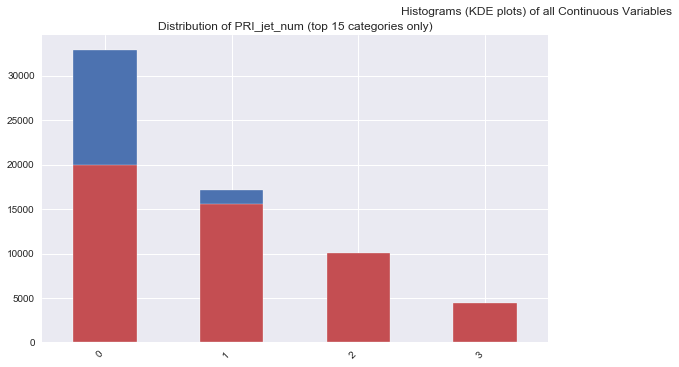

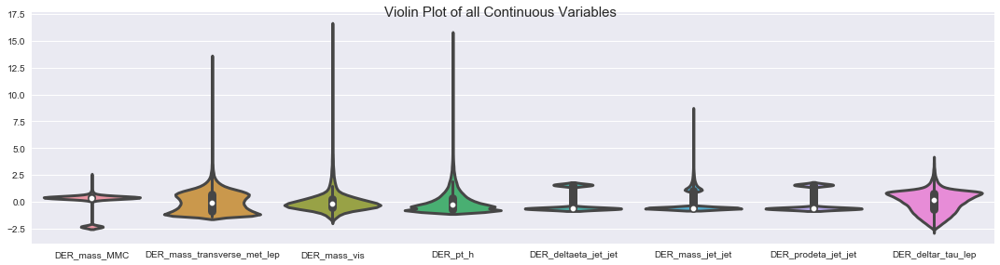

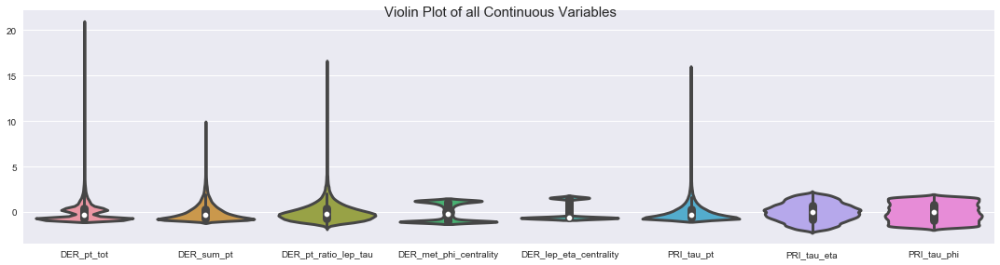

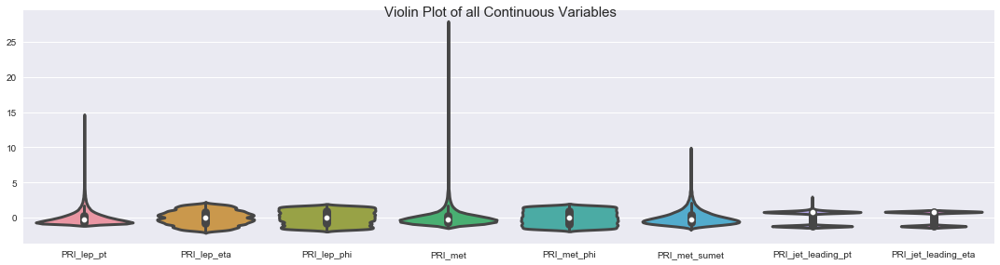

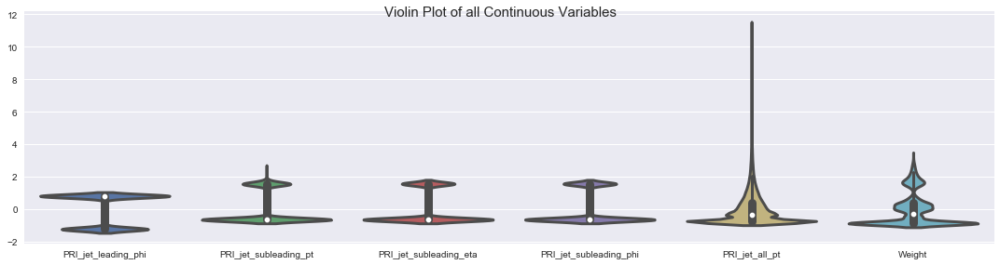

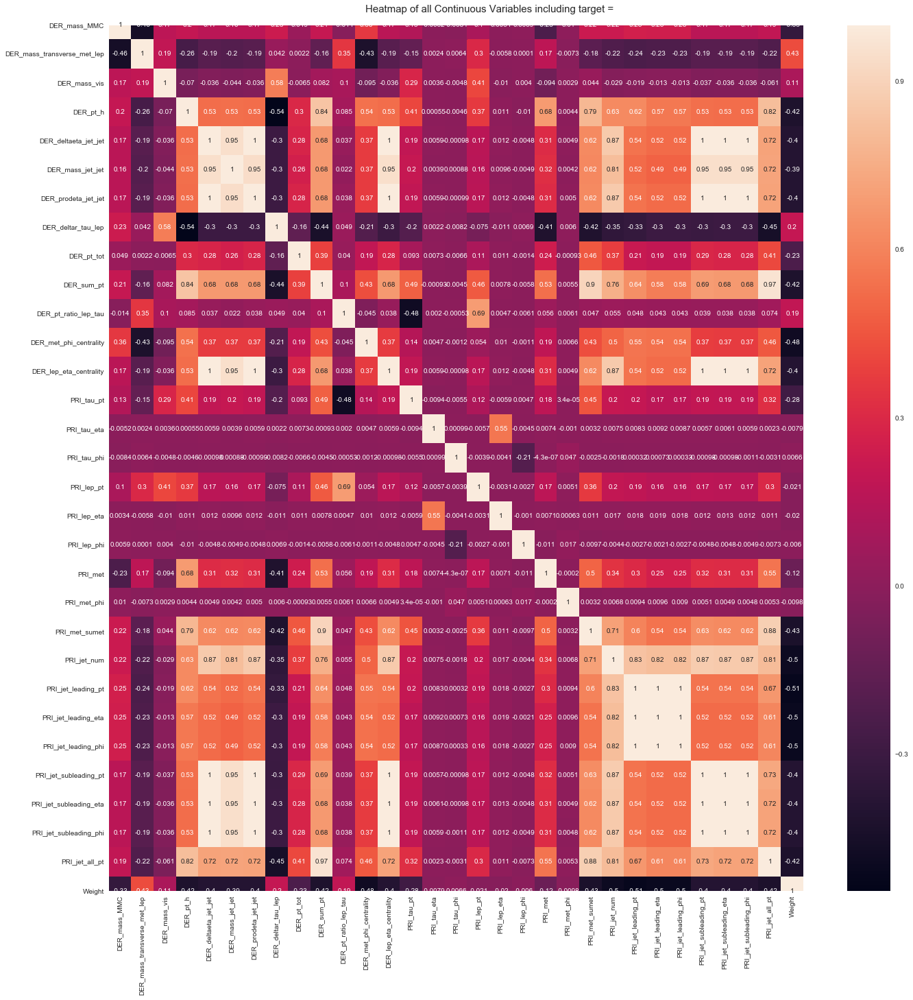

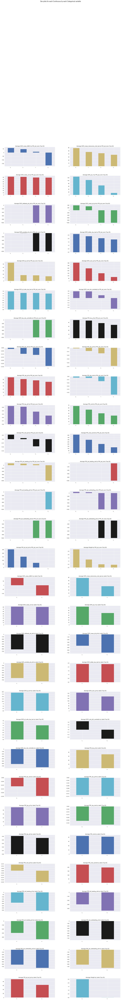

Time to run AutoViz (in seconds) = 278.366

 ###################### VISUALIZATION Completed ########################


,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight,Label
188256,125.628,2.543,87.422,87.482,-999.000,-999.000,-999.000,1.875,1.913,202.142,...,1,87.747,-0.741,1.721,-999.000,-999.000,-999.000,87.747,0.018636,s
53126,120.879,6.731,95.652,107.624,-999.000,-999.000,-999.000,1.716,23.614,196.023,...,1,93.155,-1.747,-0.100,-999.000,-999.000,-999.000,93.155,0.744056,b
172303,74.228,46.493,55.651,4.110,-999.000,-999.000,-999.000,2.834,4.110,55.255,...,0,-999.000,-999.000,-999.000,-999.000,-999.000,-999.000,0.000,4.636847,b
187965,-999.000,54.032,70.968,69.246,2.651,343.211,0.166,2.367,101.660,252.631,...,2,102.957,2.712,-1.908,70.375,0.061,1.636,173.332,0.001503,s
93404,121.800,35.585,94.329,244.685,5.573,1792.352,-7.281,0.975,2.762,442.702,...,2,171.977,-2.090,-3.008,71.441,3.483,-2.791,243.418,0.001503,s
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94578,116.618,63.788,95.055,26.214,-999.000,-999.000,-999.000,3.498,24.111,83.918,...,1,32.071,-3.867,-1.800,-999.000,-999.000,-999.000,32.071,6.040931,b
180598,145.260,5.771,100.862,1.774,-999.000,-999.000,-999.000,3.269,1.774,87.659,...,0,-999.000,-999.000,-999.000,-999.000,-999.000,-999.000,0.000,0.018636,s
32119,103.368,54.248,75.995,5.988,-999.000,-999.000,-999.000,2.858,5.988,76.530,...,0,-999.000,-999.000,-999.000,-999.000,-999.000,-999.000,0.000,4.401210,b
91014,92.593,69.467,77.563,54.165,-999.000,-999.000,-999.000,1.690,3.091,149.930,...,1,51.082,-0.498,-0.064,-999.000,-999.000,-999.000,51.082,1.681611,b


In [10]:
AV = AutoViz_Class() # instantiating the AutoViz Class
AV.AutoViz(filename = "", depVar='', dfte = dataset, header=0, verbose=0,lowess=False,max_rows_analyzed=50000)
# above command creates the visualization of the dataset

<a id='dabl'></a>

#### EDA using DABL (Data Analysis Baseline Library) auto EDA library

Target looks like classification
Showing only top 10 of 30 continuous features
Linear Discriminant Analysis training set score: 0.897


[[<Figure size 1440x288 with 10 Axes>,
  <Figure size 1152x288 with 4 Axes>,
  <Figure size 1152x288 with 4 Axes>,
  <Figure size 432x288 with 1 Axes>],
 None]

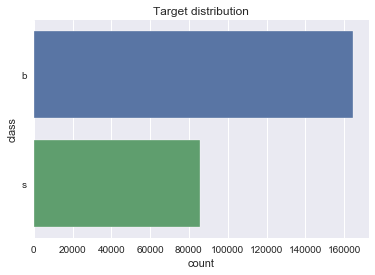

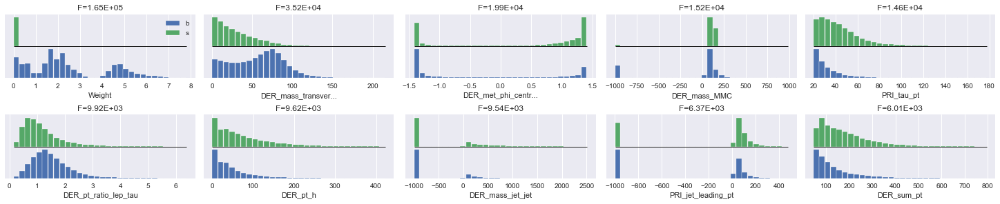

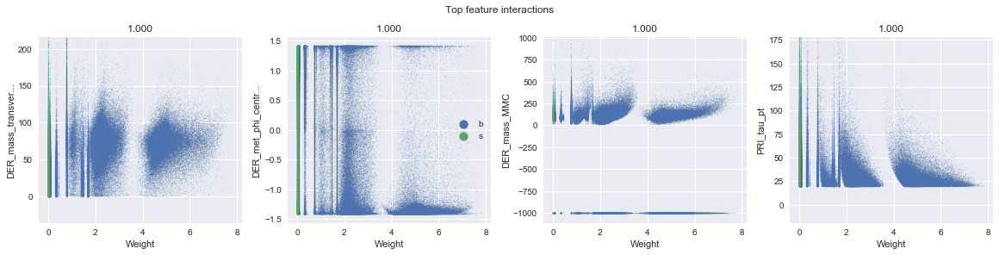

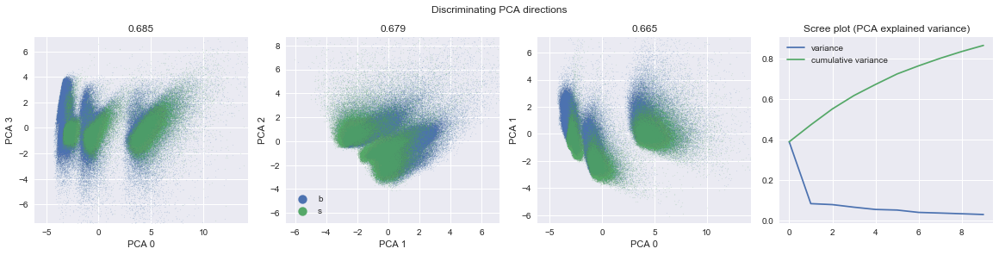

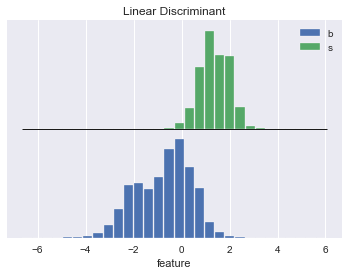

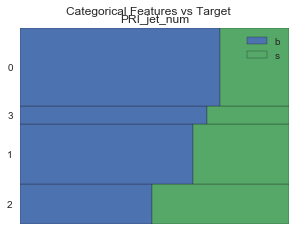

In [49]:
dabl.plot(dataset,'Label')

<a id='pre'></a>

### PREPROCESSING AND FEATURE ENGINEERING 

In [10]:
data = dataset.iloc[:,:-1] # Extracting dependent variables
data.head()

,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_met_sumet,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight
0,138.470,51.655,97.827,27.980,0.91,124.711,2.666,3.064,41.928,197.760,...,258.733,2,67.435,2.150,0.444,46.062,1.24,-2.475,113.497,0.002653
1,160.937,68.768,103.235,48.146,-999.00,-999.000,-999.000,3.473,2.078,125.157,...,164.546,1,46.226,0.725,1.158,-999.000,-999.00,-999.000,46.226,2.233584
2,-999.000,162.172,125.953,35.635,-999.00,-999.000,-999.000,3.148,9.336,197.814,...,260.414,1,44.251,2.053,-2.028,-999.000,-999.00,-999.000,44.251,2.347389
3,143.905,81.417,80.943,0.414,-999.00,-999.000,-999.000,3.310,0.414,75.968,...,86.062,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,5.446378
4,175.864,16.915,134.805,16.405,-999.00,-999.000,-999.000,3.891,16.405,57.983,...,53.131,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,6.245333


In [11]:
imp_mean = SimpleImputer(missing_values = -999.0, strategy='mean') 
# Imputation transformer for completing missing values.
imp_mean.fit(data)
X = imp_mean.transform(data)
X

array([[ 1.38470000e+02,  5.16550000e+01,  9.78270000e+01, ...,
        -2.47500000e+00,  1.13497000e+02,  2.65331134e-03],
       [ 1.60937000e+02,  6.87680000e+01,  1.03235000e+02, ...,
        -1.58228913e-03,  4.62260000e+01,  2.23358449e+00],
       [ 1.21858528e+02,  1.62172000e+02,  1.25953000e+02, ...,
        -1.58228913e-03,  4.42510000e+01,  2.34738894e+00],
       ...,
       [ 1.05457000e+02,  6.05260000e+01,  7.58390000e+01, ...,
        -1.58228913e-03,  4.19920000e+01,  1.86361167e-02],
       [ 9.49510000e+01,  1.93620000e+01,  6.88120000e+01, ...,
        -1.58228913e-03,  0.00000000e+00,  1.68161144e+00],
       [ 1.21858528e+02,  7.27560000e+01,  7.08310000e+01, ...,
        -1.58228913e-03,  0.00000000e+00,  1.87747381e+00]])

In [12]:
y = dataset.iloc[:,-1].values # extracting the labels/independent variables
y

array(['s', 'b', 'b', ..., 's', 'b', 'b'], dtype=object)

In [13]:
train_label = y.tolist()
class_names = list(set(train_label))
class_names

['b', 's']

In [14]:
class_dist = Counter(train_label)
class_dist

Counter({'s': 85667, 'b': 164333})

In [15]:
le = LabelEncoder()  
y = le.fit_transform(y) # Encoding categorical data to numeric data
y

array([1, 0, 0, ..., 1, 0, 0])

In [16]:
class_weight = {0:sum(class_dist.values())/class_dist[le.inverse_transform([0])[0]],
                1:sum(class_dist.values())/class_dist[le.inverse_transform([1])[0]]}

class_weight

{0: 1.521301260245964, 1: 2.9182765825813908}

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)
# Splitting the data into 20% test and 80% training data

In [18]:
# printing the dimensions of testing and training datasets
print("X_Train shape :", X_train.shape)
print("y_Train shape :", y_train.shape)
print("X_test shape :", X_test.shape)
print("y_test shape :", y_test.shape)

X_Train shape : (200000, 31)
y_Train shape : (200000,)
X_test shape : (50000, 31)
y_test shape : (50000,)


In [19]:
# Outlier detection and removal

iso = IsolationForest(contamination=0.1)
train_hat = iso.fit_predict(X_train)
test_hat = iso.fit_predict(X_test)
print("No of Training data outliers :",Counter(train_hat)[-1])
print("No of Testing data outliers :",Counter(test_hat)[-1])

No of Training data outliers : 20000
No of Testing data outliers : 5000


In [20]:
# select all rows that are not outliers
mask_train = train_hat != -1
mask_test = test_hat != -1
X_train, y_train = X_train[mask_train, :], y_train[mask_train]
X_test, y_test = X_test[mask_test, :], y_test[mask_test]

In [21]:
std_sc = StandardScaler()
X_train = std_sc.fit_transform(X_train) # Scaling the training data
X_train

array([[-0.24618216, -0.51664476,  0.06140849, ..., -0.01002296,
        -0.81348157, -0.91289232],
       [ 0.08201501,  0.47675802, -0.54914978, ..., -0.01002296,
        -0.81348157,  1.64640883],
       [ 0.08201501,  0.76665308,  0.96270024, ..., -0.01002296,
         1.33683311, -0.20536245],
       ...,
       [ 0.10634786, -0.73184924, -0.07346386, ..., -0.01002296,
        -0.81348157, -0.04438008],
       [-0.53215813, -1.4268529 , -0.54559185, ..., -3.07371271,
         2.7154916 , -0.87906114],
       [-0.11818805, -0.21291924, -0.2601205 , ..., -0.01002296,
        -0.81348157,  1.98311999]])

In [22]:
X_test = std_sc.transform(X_test) # Scaling the testing data
X_test

array([[ 0.23484617,  0.81437878,  0.36768922, ..., -0.01002296,
        -0.81348157, -0.92184092],
       [ 0.08201501,  0.92665675, -1.43483449, ..., -0.01002296,
        -0.81348157,  1.56298593],
       [-0.34702164,  0.35125486, -0.00380024, ..., -0.01002296,
         0.03257896,  0.20579604],
       ...,
       [ 0.08201501,  1.86152972,  2.78133927, ..., -0.01002296,
         0.0507653 ,  0.80427967],
       [-0.16517445, -0.5959354 , -0.4208551 , ..., -0.01002296,
         0.01695079, -0.92184049],
       [-1.61183684,  0.32404788, -0.8927738 , ..., -0.01002296,
        -0.81348157,  1.26733595]])

<a id='dl'></a>
### DEEP LEARNING MODELS

<a id='mlp'></a>
### MLP

In [33]:
clf = MLPClassifier(solver='adam', alpha=1e-5,hidden_layer_sizes = 15, random_state=1)
clf.fit(X_train, y_train)

MLPClassifier(alpha=1e-05, hidden_layer_sizes=15, random_state=1)

In [34]:
y_pred = clf.predict(X_test)

In [35]:
accuracy_score(y_test, y_pred)

1.0

In [36]:
confusion_matrix(y_test, y_pred)

array([[30102,     0],
       [    0, 14898]], dtype=int64)

In [37]:
print(classification_report(y_test, y_pred, target_names = ["b","s"]))

              precision    recall  f1-score   support

           b       1.00      1.00      1.00     30102
           s       1.00      1.00      1.00     14898

    accuracy                           1.00     45000
   macro avg       1.00      1.00      1.00     45000
weighted avg       1.00      1.00      1.00     45000



<a id='ann'></a>
### BASIC ANN

In [44]:
classifier = Sequential()
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dropout(0.2))
classifier.add(Dense(units = 64))
classifier.add(Dropout(0.2))
classifier.add(Dense(units = 1))
classifier.compile(optimizer = 'adam', loss = 'mean_squared_error',metrics = ["acc"])
classifier.fit(X_train,y_train, batch_size = 32, epochs = 10)
y_pred = classifier.predict(X_test)

Epoch 1/10
5625/5625 [==============================] - 5s 907us/step - loss: 0.1032 - acc: 0.8909
Epoch 2/10
5625/5625 [==============================] - 5s 910us/step - loss: 0.0338 - acc: 0.9666
Epoch 3/10
5625/5625 [==============================] - 5s 894us/step - loss: 0.0295 - acc: 0.9708
Epoch 4/10
5625/5625 [==============================] - 5s 929us/step - loss: 0.0259 - acc: 0.9740
Epoch 5/10
5625/5625 [==============================] - 5s 907us/step - loss: 0.0240 - acc: 0.9770
Epoch 6/10
5625/5625 [==============================] - 5s 904us/step - loss: 0.0226 - acc: 0.9792
Epoch 7/10
5625/5625 [==============================] - 5s 891us/step - loss: 0.0240 - acc: 0.9782
Epoch 8/10
5625/5625 [==============================] - 5s 887us/step - loss: 0.0213 - acc: 0.9824
Epoch 9/10
5625/5625 [==============================] - 5s 866us/step - loss: 0.0200 - acc: 0.9848
Epoch 10/10
5625/5625 [==============================] - 5s 846us/step - loss: 0.0194 - acc: 0.9875


In [53]:
y_pred = [0 if y_pred[i] <=0.5 else 1 for i in range(len(y_pred))]

In [55]:
accuracy_score(y_test, y_pred)

0.9798222222222223

In [56]:
confusion_matrix(y_test, y_pred)

array([[29240,   862],
       [   46, 14852]], dtype=int64)

In [57]:
print(classification_report(y_test, y_pred, target_names = ["b","s"]))

              precision    recall  f1-score   support

           b       1.00      0.97      0.98     30102
           s       0.95      1.00      0.97     14898

    accuracy                           0.98     45000
   macro avg       0.97      0.98      0.98     45000
weighted avg       0.98      0.98      0.98     45000



<a id='auto'></a>
### AUTOENCODER

In [65]:
# No of encoding dimensions
encoding_dim = 32
input_layer = Input(X_train.shape[1])
# Encoder
encoder = Dense(encoding_dim, activation ="tanh")(input_layer)
encoder = Dense(int(encoding_dim / 2), activation = "relu")(encoder)
# Decoder
decoder = Dense(int(encoding_dim / 2), activation ='tanh')(encoder)
decoder = Dense(1, activation ='relu')(decoder)
autoencoder = Model(inputs=input_layer, outputs = decoder)
autoencoder.compile(optimizer ='adam',loss='mean_squared_error',metrics = ["acc"])
autoencoder.fit(X_train, y_train,epochs = 10,batch_size = 32)
predictions = autoencoder.predict(X_test)

Epoch 1/10
5625/5625 [==============================] - 4s 689us/step - loss: 0.0616 - acc: 0.9182
Epoch 2/10
5625/5625 [==============================] - 4s 759us/step - loss: 0.0240 - acc: 0.9693
Epoch 3/10
5625/5625 [==============================] - 4s 742us/step - loss: 0.0198 - acc: 0.9746
Epoch 4/10
5625/5625 [==============================] - 4s 758us/step - loss: 0.0187 - acc: 0.9753
Epoch 5/10
5625/5625 [==============================] - 4s 715us/step - loss: 0.0172 - acc: 0.9772
Epoch 6/10
5625/5625 [==============================] - 4s 713us/step - loss: 0.0161 - acc: 0.9790
Epoch 7/10
5625/5625 [==============================] - 4s 713us/step - loss: 0.0149 - acc: 0.9805
Epoch 8/10
5625/5625 [==============================] - 4s 716us/step - loss: 0.0131 - acc: 0.9834
Epoch 9/10
5625/5625 [==============================] - 4s 730us/step - loss: 0.0119 - acc: 0.9849
Epoch 10/10
5625/5625 [==============================] - 4s 733us/step - loss: 0.0114 - acc: 0.9856


In [68]:
predictions = [0 if predictions[i] <=0.5 else 1 for i in range(len(predictions))]
accuracy_score(y_test, predictions)

0.9850666666666666

In [70]:
confusion_matrix(y_test, predictions)

array([[29753,   349],
       [  323, 14575]], dtype=int64)

In [71]:
print(classification_report(y_test, predictions, target_names = ["b","s"]))

              precision    recall  f1-score   support

           b       0.99      0.99      0.99     30102
           s       0.98      0.98      0.98     14898

    accuracy                           0.99     45000
   macro avg       0.98      0.98      0.98     45000
weighted avg       0.99      0.99      0.99     45000



<a id='rnn'></a>
### RNN

In [72]:
Xtrain = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
# Reshape the data
Xtest = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1 ))

In [78]:
print("Recurrent neural network (RNN)")

model = Sequential()
model.add(SimpleRNN(units=4, input_shape=(Xtrain.shape[1], Xtrain.shape[2])))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam',metrics = ["acc"])
model.fit(Xtrain, y_train, epochs=10, batch_size=32)
# predicting the opening prices
prediction = model.predict(Xtest)

Recurrent neural network (RNN)
Epoch 1/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0853 - acc: 0.8967
Epoch 2/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0394 - acc: 0.9488
Epoch 3/10
5625/5625 [==============================] - 12s 2ms/step - loss: 0.0351 - acc: 0.9540
Epoch 4/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0326 - acc: 0.9552
Epoch 5/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0309 - acc: 0.9546
Epoch 6/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0293 - acc: 0.9545
Epoch 7/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0278 - acc: 0.9552
Epoch 8/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0265 - acc: 0.9556
Epoch 9/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0259 - acc: 0.9549
Epoch 10/10
5625/5625 [==============================] - 13s 2ms/step - loss: 0.0247 - 

In [80]:
predictions = [0 if prediction[i] <=0.5 else 1 for i in range(len(prediction))]
accuracy_score(y_test, predictions)

0.9850666666666666

In [81]:
confusion_matrix(y_test, predictions)

array([[29753,   349],
       [  323, 14575]], dtype=int64)

In [82]:
print(classification_report(y_test, predictions, target_names = ["b","s"]))

              precision    recall  f1-score   support

           b       0.99      0.99      0.99     30102
           s       0.98      0.98      0.98     14898

    accuracy                           0.99     45000
   macro avg       0.98      0.98      0.98     45000
weighted avg       0.99      0.99      0.99     45000

